# Towards Green Cities


# Introduction
### Motivation
- This project in focused on green spaces in cities specifically urban trees. There is a great value for urban trees such as they increase urban diversity, decrease pollution as they work as  afilter for urban pollutants. Also, they can help with climat change since every Mature tree can absorb 150 kg of CO2 Per year.
- Additonally, there are many movements and projects for tree planting and watering which also shows the importance of this subject.

###  Questions to answer
- Which Areas need more trees?
- Can we classify street to green/not green roads? 
- How to decide which tree type to plant (regular people)?
- Can the community contribuate to watering street trees?

### Dataset description:
####  Tree (les arbres) 
- from paris open source website ( http://tiny.cc/xud6tz) it was created on 2001 by the Department of Green Spaces and the Environment – Paris City Hall and it is updated weekly 


In [2]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
from geopandas.tools import sjoin
from scipy.spatial import cKDTree
from shapely.geometry import Point
from sklearn.neighbors import BallTree
import math



### Data Loading and Analysis

In [3]:
tree_data = pd.read_excel('les-arbres.xlsx')

In [4]:
tree_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204347 entries, 0 to 204346
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   IDBASE                  204347 non-null  int64  
 1   TYPE EMPLACEMENT        204347 non-null  object 
 2   DOMANIALITE             204347 non-null  object 
 3   ARRONDISSEMENT          204347 non-null  object 
 4   COMPLEMENT ADRESSE      40649 non-null   object 
 5   NUMERO                  0 non-null       float64
 6   LIEU / ADRESSE          204347 non-null  object 
 7   IDEMPLACEMENT           204347 non-null  object 
 8   LIBELLE FRANCAIS        203579 non-null  object 
 9   GENRE                   204346 non-null  object 
 10  ESPECE                  202271 non-null  object 
 11  VARIETE OUCULTIVAR      37993 non-null   object 
 12  CIRCONFERENCE (cm)      204347 non-null  int64  
 13  HAUTEUR (m)             204347 non-null  int64  
 14  STADE DE DEVELOPPEME

In [5]:

fig = go.Figure()

fig.add_trace(go.Indicator(
    value = tree_data.shape[0],
    title = {'text':'# of trees','font':{'size':12,'color':'#013220'}},
    number = {'font':{'size':40,'color':'green'} },
    domain = {'row': 0, 'column': 0})
    )

    
fig.add_trace(go.Indicator(
    value = tree_data['LIBELLE FRANCAIS'].nunique(),
    number = {'font':{'size':40,'color':'green'}},
    title =  {'text':'# of types','font':{'size':12,'color':'#013220'}},domain = {'row': 0, 'column': 1})
    
    )
fig.add_trace(go.Indicator(
    value = tree_data['ESPECE'].nunique(),
    number = {'font':{'size':40,'color':'green'}},
    title =  {'text':'# of subtypes','font':{'size':12,'color':'#013220'}},domain = {'row': 0, 'column': 2})
    
    )
fig.add_trace(go.Indicator(
    value = tree_data['ARRONDISSEMENT'].nunique(),
    number = {'font':{'size':40,'color':'green'}},
    title = {'text':'# of Districts','font':{'size':12,'color':'#013220'}},
    domain = {'row': 0, 'column': 3})
    
    )

fig.update_layout(
    grid = {'rows': 1, 'columns': 4},
    template = 'ygridoff'
    
                         )

In [6]:
genre_count = tree_data['LIBELLE FRANCAIS'].value_counts().reset_index().rename(columns={'index':'Genre','LIBELLE FRANCAIS':'Count'})

In [7]:
fig = px.bar(genre_count.iloc[0:25], x='Genre', y='Count',color_discrete_sequence =['green']*len(genre_count.iloc[0:25]))
fig.update_layout(
    
    template = 'ggplot2'
    
                         )
fig.update_xaxes(tickangle=30)
fig.show()

In [8]:
District_Tree_count = tree_data['ARRONDISSEMENT'].value_counts().reset_index().rename(columns={'index':'Arrondissement','ARRONDISSEMENT':'Count'})

In [9]:
import plotly.express as px
fig = px.bar(District_Tree_count, x='Arrondissement', y='Count',color_discrete_sequence =['green']*len(District_Tree_count))
fig.update_layout(
    
    template = 'ggplot2'
    
                         )
fig.show()


In [10]:
Cir_mean = tree_data.groupby(['LIBELLE FRANCAIS'])['CIRCONFERENCE (cm)'].mean().reset_index()
high_mean = tree_data.groupby(['LIBELLE FRANCAIS'])['HAUTEUR (m)'].mean().reset_index()
full = Cir_mean.merge(high_mean, how = 'left',on='LIBELLE FRANCAIS')
full['CIRCONFERENCE (m)'] = full['CIRCONFERENCE (cm)']/100

In [11]:
fig = px.scatter(full, x='CIRCONFERENCE (m)', y='HAUTEUR (m)',color_discrete_sequence =['brown']*len(full['CIRCONFERENCE (m)'])
                )
fig.update_layout(
    
    template = 'ggplot2'
    
                         )
fig.update_traces(marker=dict(size=8))


fig.show()

## Spatial Analysis

In [12]:
# Getting Lang and Lat
tree_data['lat'] = tree_data['geo_point_2d'].apply(lambda x:x.split(',')[0])
tree_data['lang'] = tree_data['geo_point_2d'].apply(lambda x:x.split(',')[1])

In [13]:
gdf = gpd.GeoDataFrame(
    tree_data, geometry=gpd.points_from_xy(tree_data.lang, tree_data.lat),crs={'init':'epsg:4326'})

/Users/danaalmanla/opt/anaconda3/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



In [14]:
shapefile = gpd.read_file("arrondissements/arrondissements.shp")

In [15]:
tree_data['lang'] = tree_data['lang'].astype('float64')
tree_data['lat'] = tree_data['lat'].astype('float64')



In [16]:
tree_data['size'] = 0.01

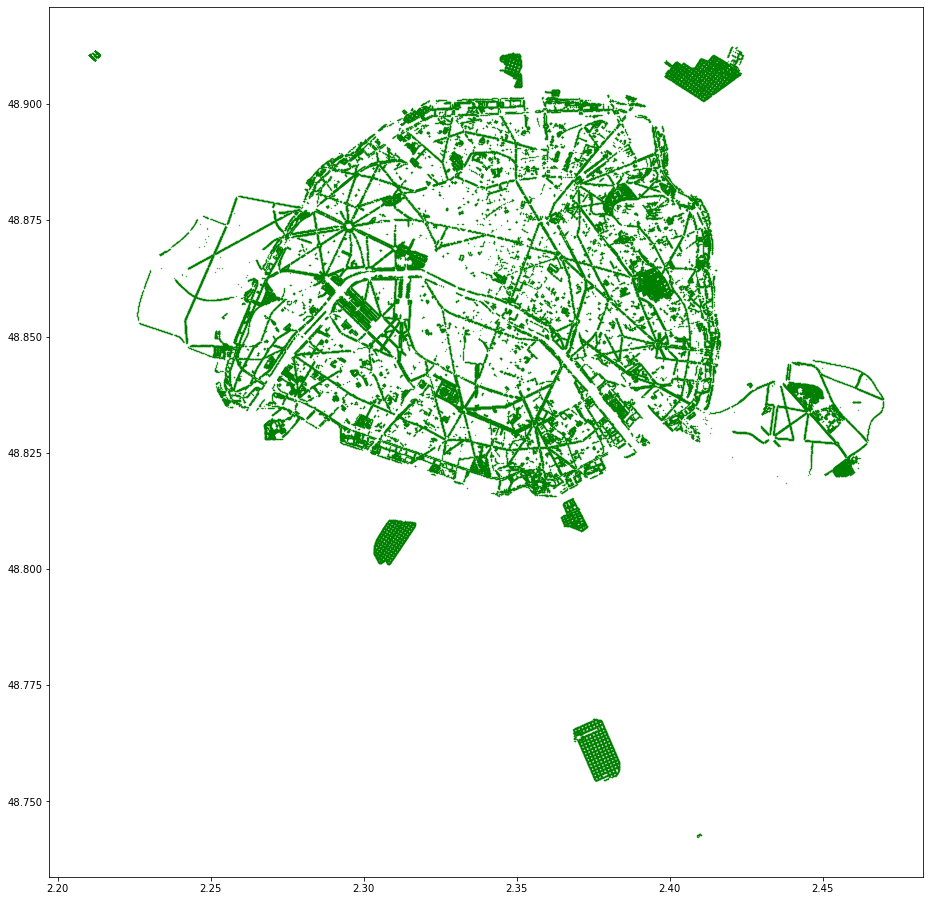

In [17]:
fig, ax = plt.subplots(figsize = (20,16))
shapefile.plot(ax=ax,color='white',)
gdf.plot(ax=ax, color='green',markersize=0.1)
plt.show()




In [18]:

fig = px.scatter_mapbox(tree_data, lat="lat", lon="lang",
                         zoom=8, height=600,  color_discrete_sequence=["green"],size_max=0.5,labels={'GENRE':'GENRE'})
fig.update_layout(mapbox_style="open-street-map")
fig.update_traces(marker=dict(size=2.5))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [19]:
## Calculating Area of every district
paris = shapefile.copy()
paris= paris.to_crs({'init': 'epsg:3857'})
print(paris.crs)
paris.head(2)
paris["area"] = paris['geometry'].area/ 10**3
paris= paris.to_crs({'init': 'epsg:32633'})
paris["area"] = paris['geometry'].area/ 10**3

/Users/danaalmanla/opt/anaconda3/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



+init=epsg:3857 +type=crs


In [20]:
to_map_main = paris[['c_ar','area']]

In [21]:
District_Tree_count_to_map = tree_data['ARRONDISSEMENT'].value_counts().reset_index().rename(columns={'index':'ARRONDISSEMEN','ARRONDISSEMENT':'Count'})

In [22]:
map_district_number = {'PARIS 1ER ARRDT':1,
                      'PARIS 2E ARRDT':2,
                      'PARIS 3E ARRDT':3,
                      'PARIS 4E ARRDT':4,
                      'PARIS 5E ARRDT':5,
                      'PARIS 6E ARRDT':6,
                      'PARIS 7E ARRDT':7,
                      'PARIS 8E ARRDT':8,
                      'PARIS 9E ARRDT':9,
                      'PARIS 10E ARRDT':10,
                      'PARIS 11E ARRDT':11,
                      'PARIS 12E ARRDT':12,
                      'PARIS 13E ARRDT':13,
                      'PARIS 14E ARRDT':14,
                      'PARIS 15E ARRDT':15,
                      'PARIS 16E ARRDT':16,
                      'PARIS 17E ARRDT':17,
                      'PARIS 18E ARRDT':18,
                      'PARIS 19E ARRDT':19,
                      'PARIS 20E ARRDT':20,
                      }

In [23]:
District_Tree_count_to_map['c_ar'] = District_Tree_count_to_map['ARRONDISSEMEN'].map(map_district_number)

In [24]:
District_Tree_count_to_map = District_Tree_count_to_map.dropna()

In [25]:
District_Tree_count_to_map = District_Tree_count_to_map.merge(to_map_main, how='left',on='c_ar')

In [26]:
District_Tree_count_to_map['Coverage'] = District_Tree_count_to_map['Count']/District_Tree_count_to_map['area']

In [27]:
District_Tree_count_to_map['Coverage_from_100'] = District_Tree_count_to_map['Coverage']-District_Tree_count_to_map['Coverage'].min()
District_Tree_count_to_map['Coverage_from_100'] = (District_Tree_count_to_map['Coverage_from_100']/District_Tree_count_to_map['Coverage_from_100'].max())*100
District_Tree_count_to_map

,ARRONDISSEMEN,Count,c_ar,area,Coverage,Coverage_from_100
0,PARIS 15E ARRDT,17215,15.0,8672.501152,1.985010,71.498078
1,PARIS 13E ARRDT,16863,13.0,7297.215050,2.310882,87.465993
2,PARIS 16E ARRDT,16794,16.0,16715.584518,1.004691,23.461867
3,PARIS 20E ARRDT,15672,20.0,6105.955415,2.566674,100.000000
4,PARIS 19E ARRDT,14424,19.0,6931.724040,2.080868,76.195167
5,PARIS 12E ARRDT,12598,12.0,16648.807590,0.756691,11.309700
6,PARIS 14E ARRDT,11783,14.0,5731.703842,2.055759,74.964815
7,PARIS 17E ARRDT,10851,17.0,5786.386664,1.875264,66.120444
8,PARIS 18E ARRDT,10423,18.0,6119.476364,1.703250,57.691690
9,PARIS 7E ARRDT,8691,7.0,4175.097621,2.081628,76.232426


In [28]:
paris_with_coverage = paris.merge(District_Tree_count_to_map[['Coverage','ARRONDISSEMEN','c_ar','Coverage_from_100']], how = 'left',on='c_ar')

In [29]:
paris_with_coverage['coords'] = paris_with_coverage['geometry'].apply(lambda x: x.representative_point().coords[:])
paris_with_coverage['coords'] = [coords[0] for coords in paris_with_coverage['coords']]

In [30]:
paris_with_coverage['ARRONDISSEMEN'] = paris_with_coverage['ARRONDISSEMEN'].apply(lambda x:x.replace('PARIS',''))

<ipython-input-31-df41f302b3af>:6: MatplotlibDeprecationWarning:

The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.



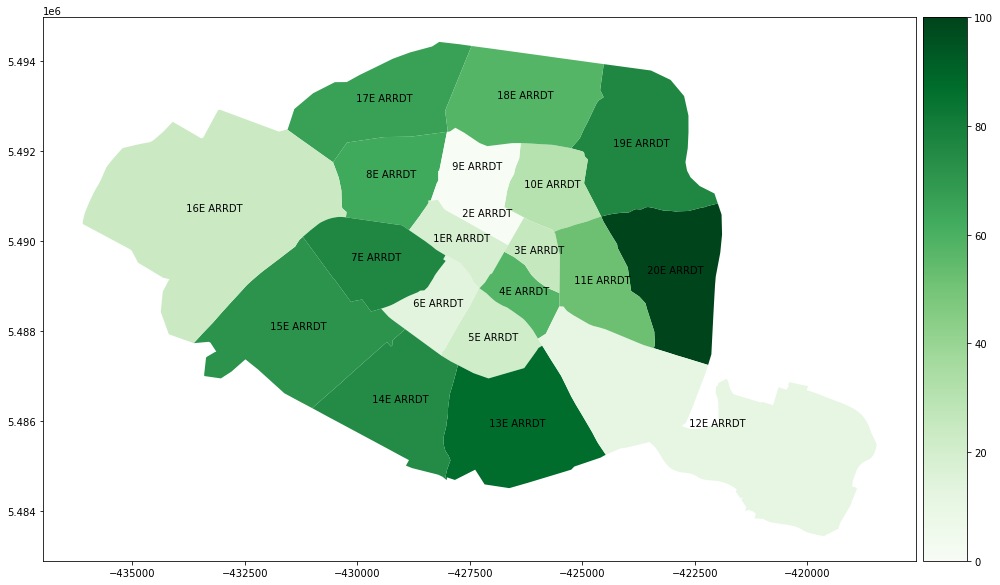

In [31]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
fig, ax = plt.subplots(figsize = (20,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
paris_with_coverage.plot(ax=ax,column='Coverage_from_100',legend=True,cax=cax,cmap='Greens')
paris_with_coverage.apply(lambda x: ax.annotate(s=x.ARRONDISSEMEN, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);


Districts in the middle have less trees population than the outer ones

# Road street , Tree Distribuation

In [32]:
shapefile_roads = gpd.read_file("france-roads-shape/roads.shp")

<AxesSubplot:>

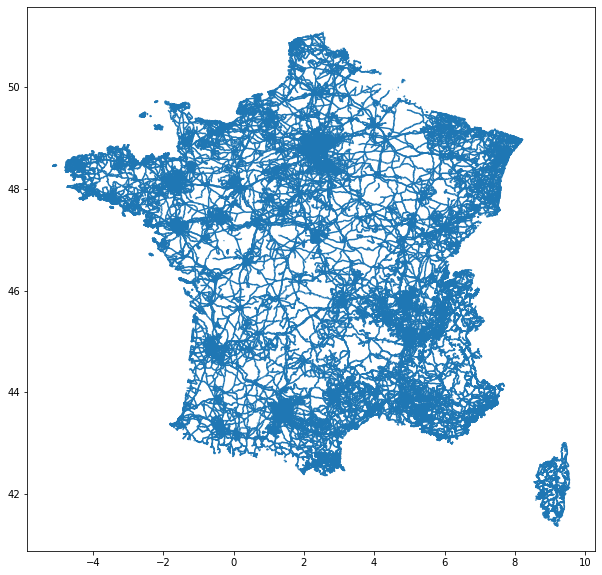

In [33]:
fig, ax = plt.subplots(figsize = (20,10))
shapefile_roads.plot(ax=ax)

In [34]:
# extract Paris roads
pointInPolys = sjoin(shapefile_roads, shapefile)
pointInPolys.head()

,osm_id,name,ref,type,oneway,maxspeed,geometry,index_right,n_sq_ar,c_ar,c_arinsee,l_ar,l_aroff,n_sq_co,surface,perimetre
0,2569,Rue Nationale,None,tertiary,1,0,"LINESTRING (2.36947 48.82161, 2.36868 48.82290...",9,750000013.0,13.0,75113.0,13Ã¨me Ardt,Gobelins,750001537.0,7.149311e+06,11546.546526
1,2570,Avenue des Gobelins,None,secondary,0,0,"LINESTRING (2.35537 48.83182, 2.35506 48.83219...",9,750000013.0,13.0,75113.0,13Ã¨me Ardt,Gobelins,750001537.0,7.149311e+06,11546.546526
2,2573,Place des Alpes,None,unclassified,0,0,"LINESTRING (2.35858 48.83214, 2.35841 48.83217...",9,750000013.0,13.0,75113.0,13Ã¨me Ardt,Gobelins,750001537.0,7.149311e+06,11546.546526
94,1345035,Rue Fagon,None,unclassified,0,30,"LINESTRING (2.35653 48.83278, 2.35841 48.83217)",9,750000013.0,13.0,75113.0,13Ã¨me Ardt,Gobelins,750001537.0,7.149311e+06,11546.546526
200,1881495,Rue Sthrau,None,unclassified,0,0,"LINESTRING (2.36578 48.82818, 2.36673 48.82791...",9,750000013.0,13.0,75113.0,13Ã¨me Ardt,Gobelins,750001537.0,7.149311e+06,11546.546526


In [35]:
list_street_to_keep = ['residential','footway','secondary','unclassified','primary']


Extract paris roads only

<AxesSubplot:>

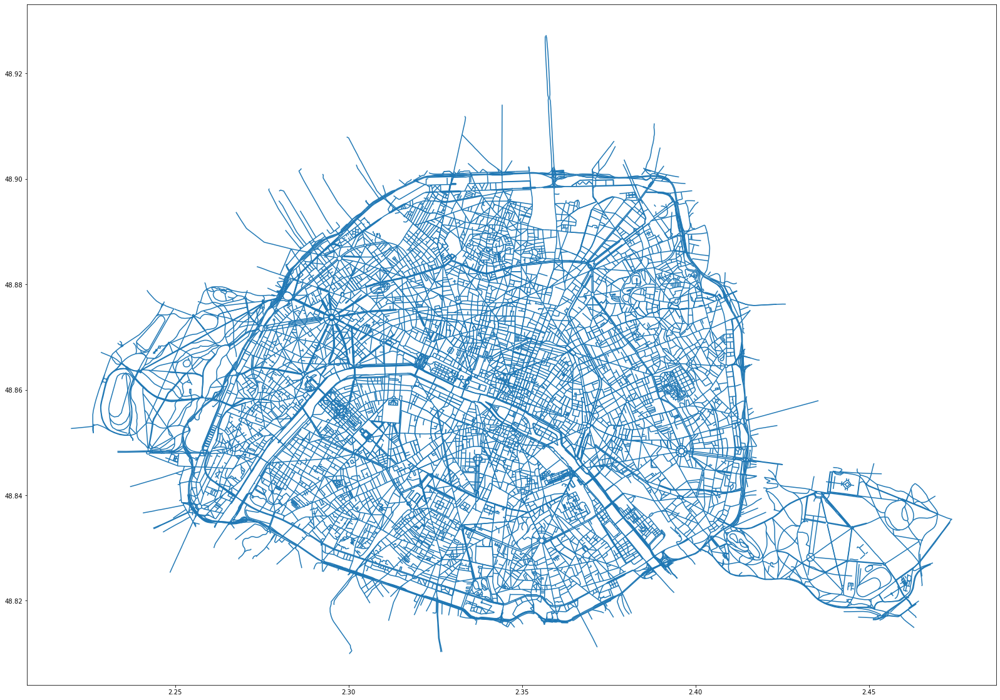

In [36]:
fig, ax = plt.subplots(figsize = (30,20))

pointInPolys.plot(ax=ax, )

<AxesSubplot:>

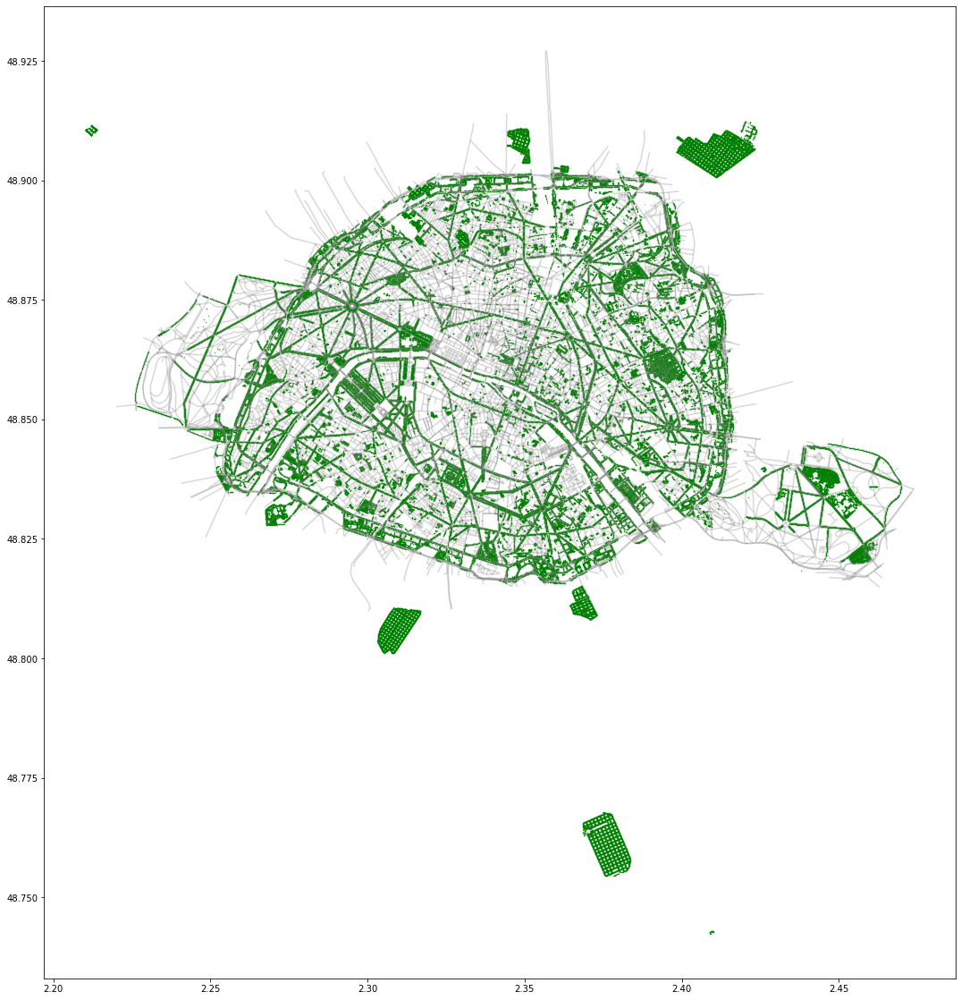

In [37]:
fig, ax = plt.subplots(figsize = (30,20))

gdf.plot(ax=ax, color='green',markersize=0.1)
pointInPolys.plot(ax=ax, color = 'grey', alpha=0.3)

# Network for type of trees

In [38]:
tree_data_part = tree_data[0:10000]

In [39]:

def get_nearest(src_points, candidates, k_neighbors=1):
    """Find nearest neighbors for all source points from a set of candidate points"""
    tree = BallTree(candidates, leaf_size=15, metric='haversine')
    distances, indices = tree.query(src_points, k=k_neighbors)
    distances = distances.transpose()
    indices = indices.transpose()
    closest = indices[0]
    closest_dist = distances[0]
    return (closest, closest_dist)


def nearest_neighbor(left_gdf, right_gdf, return_dist=False):
    left_geom_col = left_gdf.geometry.name
    right_geom_col = right_gdf.geometry.name
    right = right_gdf.copy().reset_index(drop=True)
    left_radians = np.array(left_gdf[left_geom_col].apply(lambda geom: (geom.x * np.pi / 180, geom.y * np.pi / 180)).to_list())
    right_radians = np.array(right[right_geom_col].apply(lambda geom: (geom.x * np.pi / 180, geom.y * np.pi / 180)).to_list())
    closest, dist = get_nearest(src_points=left_radians, candidates=right_radians)
    closest_points = right.loc[closest]
    closest_points = closest_points.reset_index(drop=True)
    if return_dist:
        earth_radius = 6371000  # meters
        closest_points['distance'] = dist * earth_radius
    return closest

In [ ]:
# Don't run this cell it will take time
combinations_g=[]
combinations_s=[]
counter =0
for i in range(0,tree_data_part.shape[0]):
    part_data = tree_data.drop([i])
    closest = nearest_neighbor(tree_data_part.iloc[i:i+1], part_data, return_dist=False)
    combinations_g.append([part_data.iloc[closest]['LIBELLE FRANCAIS'],tree_data_part.iloc[i:i+1]['LIBELLE FRANCAIS']])
    combinations_s.append([part_data.iloc[closest]['ESPECE'],tree_data_part.iloc[i:i+1]['ESPECE']])
    counter = counter+1
    if (counter%100==0):
        print(counter)

In [ ]:
combinations_g_3 = []
for i in range(0,len(combinations_g)):
    x= combinations_g[i][0].values[0]
    y = combinations_g[i][1].values[0]
    combinations_g_3.append([x,y])

In [ ]:
for h in combinations_g_3:
            
    if len(h)>1:
                
        s=h[0]
        for t in h[1:]:
            if (s,t) in Eg:
                Eg[(s,t)]+=1
            else:
                Eg[(s,t)]=1

In [ ]:
F = open('trees_net_data.csv', 'w') 

F.write('Source,Target,Weight\n')
for e in Eg:
    F.write('%s,%s,%0.2f\n'%(e[0],e[1],Eg[e]))

F.close()

## Genre Tree Network using Gephi 
The idea is to recommend what Genre of trees goes usually together

<img src="Tree_network_ppt.png" alt="Drawing" style="width: 800px;"/>

